In [1]:
!pip install kaggle


In [2]:
from google.colab import files
files.upload()


Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"shreyanalawade882","key":"095cfc8336b902fb803df8bd0e6fa278"}'}

In [3]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json


In [4]:
!kaggle datasets download -d requiemonk/sentinel12-image-pairs-segregated-by-terrain/


Dataset URL: https://www.kaggle.com/datasets/requiemonk/sentinel12-image-pairs-segregated-by-terrain/versions/
License(s): Attribution 4.0 International (CC BY 4.0)
100% 2.54G/2.55G [00:34<00:00, 63.2MB/s]
100% 2.55G/2.55G [00:34<00:00, 79.0MB/s]


In [5]:
!ls /content


kaggle.json  sample_data  sentinel12-image-pairs-segregated-by-terrain.zip


In [6]:
!unzip /content/sentinel12-image-pairs-segregated-by-terrain.zip -d /content/


Streaming output truncated to the last 5000 lines.
  inflating: /content/v_2/urban/s1/ROIs1970_fall_s1_52_p41.png  
  inflating: /content/v_2/urban/s1/ROIs1970_fall_s1_52_p410.png  
  inflating: /content/v_2/urban/s1/ROIs1970_fall_s1_52_p411.png  
  inflating: /content/v_2/urban/s1/ROIs1970_fall_s1_52_p412.png  
  inflating: /content/v_2/urban/s1/ROIs1970_fall_s1_52_p413.png  
  inflating: /content/v_2/urban/s1/ROIs1970_fall_s1_52_p414.png  
  inflating: /content/v_2/urban/s1/ROIs1970_fall_s1_52_p415.png  
  inflating: /content/v_2/urban/s1/ROIs1970_fall_s1_52_p416.png  
  inflating: /content/v_2/urban/s1/ROIs1970_fall_s1_52_p417.png  
  inflating: /content/v_2/urban/s1/ROIs1970_fall_s1_52_p418.png  
  inflating: /content/v_2/urban/s1/ROIs1970_fall_s1_52_p419.png  
  inflating: /content/v_2/urban/s1/ROIs1970_fall_s1_52_p420.png  
  inflating: /content/v_2/urban/s1/ROIs1970_fall_s1_52_p434.png  
  inflating: /content/v_2/urban/s1/ROIs1970_fall_s1_52_p435.png  
  inflating: /content/v_2/

In [7]:
!ls /content/v_2/

agri  barrenland  grassland  urban


In [8]:
import os
import glob

In [9]:
base_dir = "/content/v_2"
categories = ['agri', 'barrenland', 'grassland', 'urban']



In [10]:

import numpy as np


In [11]:
# Collecting all pairs of input and output image paths
input_output_pairs = []
for category in categories:
    input_folder = os.path.join(base_dir, category, 's1')  # Sentinel-1 images (input)
    output_folder = os.path.join(base_dir, category, 's2')  # Sentinel-2 images (output)

    # List all image files in the input and output folders
    input_images = sorted(os.listdir(input_folder))
    output_images = sorted(os.listdir(output_folder))

    # Make sure each input image has a corresponding output image
    for input_img, output_img in zip(input_images, output_images):
        input_img_path = os.path.join(input_folder, input_img)
        output_img_path = os.path.join(output_folder, output_img)
        input_output_pairs.append((input_img_path, output_img_path))

# Check size of dataset
print(f"Size of dataset: {len(input_output_pairs)}")

# Shuffle and split the dataset into training and validation sets
np.random.seed(123)  # Seeding for reproducibility
input_output_pairs = np.random.permutation(input_output_pairs)  # Shuffling the pairs

# Split: 80% for training, 20% for validation
split_index = int(0.8 * len(input_output_pairs))
train_pairs = input_output_pairs[:split_index]
val_pairs = input_output_pairs[split_index:]

print(f"Training pairs: {len(train_pairs)}, Validation pairs: {len(val_pairs)}")

Size of dataset: 16000
Training pairs: 12800, Validation pairs: 3200


In [12]:
# Example: Accessing a pair
example_input, example_output = train_pairs[0]
print("Example input image path:", example_input)
print("Example output image path:", example_output)

Example input image path: /content/v_2/grassland/s1/ROIs1970_fall_s1_11_p427.png
Example output image path: /content/v_2/grassland/s2/ROIs1970_fall_s2_11_p427.png


In [13]:
def show_images(paths):
    _, axes = plt.subplots(1, 2, figsize=(2, 2))
    for ax, img_path in zip(axes.flatten(), [image_path, rgb_image_path]):
        ax.imshow(Image.open(img_path))
        ax.axis("off")

In [14]:
!pip install torchvision

import numpy as np
from PIL import Image
#Import Dataset class
from torch.utils.data import Dataset
import torchvision.transforms as transforms
from skimage.color import rgb2lab,lab2rgb
from torch.utils.data import DataLoader
import os
import glob
import time
import numpy as np
from PIL import Image
from pathlib import Path
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb

import torch
from torch import nn, optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader

In [15]:
SIZE = 256

class ColorizationDataset(Dataset):
    def __init__(self, pairs, split='train'):
        if split == 'train':
            self.transforms = transforms.Compose([
                transforms.Resize((SIZE, SIZE), Image.BICUBIC),
                transforms.RandomHorizontalFlip(),  # Data augmentation for training
            ])
        elif split == 'val':
            self.transforms = transforms.Resize((SIZE, SIZE), Image.BICUBIC)

        self.split = split
        self.size = SIZE
        self.pairs = pairs  # Now holds pairs of input and output paths

    def __getitem__(self, idx):
        input_path, output_path = self.pairs[idx]  # Unpack the pair

        # Open and process input image (s1)
        input_img = Image.open(input_path)
        input_img = self.transforms(input_img)
        input_img = np.array(input_img)
        input_lab = transforms.ToTensor()(input_img)
        L = input_lab[[0], ...]#  / 50.-1.# L channel normalized to [-1, 1]
        # print(L)

        # Open and process output image (s2)
        output_img = Image.open(output_path).convert("RGB")
        output_img = self.transforms(output_img)
        output_img = np.array(output_img)
        output_lab = rgb2lab(output_img).astype("float32")
        output_lab = transforms.ToTensor()(output_lab)
        ab = output_lab[[1, 2], ...]# / (torch.max(output_lab) - torch.min(output_lab))  # ab channels normalized to [-1, 1]

        return {'L': L, 'ab': ab}

    def __len__(self):
        return len(self.pairs)

def make_dataloaders(batch_size=16, n_workers=4, pin_memory=True, **kwargs):
    dataset = ColorizationDataset(**kwargs)
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers, pin_memory=pin_memory)
    return dataloader

# Create dataloaders using input-output pairs
train_dl = make_dataloaders(pairs=train_pairs, split='train')
val_dl = make_dataloaders(pairs=val_pairs, split='val')

data = next(iter(train_dl))
Ls, abs_ = data['L'], data['ab']
print(Ls.shape, abs_.shape)
print(len(train_dl), len(val_dl))

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])
800 200


In [16]:
import torch.nn as nn

In [17]:
class UnetBlock(nn.Module):
    def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False,
                 innermost=False, outermost=False):
        super().__init__()
        self.outermost = outermost
        if input_c is None: input_c = nf
        downconv = nn.Conv2d(input_c, ni, kernel_size=4,
                             stride=2, padding=1, bias=False)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = nn.BatchNorm2d(ni)
        uprelu = nn.ReLU(True)
        upnorm = nn.BatchNorm2d(nf)

        if outermost:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1)
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]
            if dropout: up += [nn.Dropout(0.5)]
            model = down + [submodule] + up
        self.model = nn.Sequential(*model)

    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:
            return torch.cat([x, self.model(x)], 1)

class Unet(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)

    def forward(self, x):
        return self.model(x)

In [18]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2)
                          for i in range(n_down)] # the 'if' statement is taking care of not using
                                                  # stride of 2 for the last block in this loop
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)] # Make sure to not use normalization or
                                                                                             # activation for the last layer of the model
        self.model = nn.Sequential(*model)

    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True): # when needing to make some repeatitive blocks of layers,
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]          # it's always helpful to make a separate method for that purpose
        if norm: layers += [nn.BatchNorm2d(nf)]
        if act: layers += [nn.LeakyReLU(0.2, True)]
        return nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)

In [19]:
PatchDiscriminator(100)

PatchDiscriminator(
  (model): Sequential(
    (0): Sequential(
      (0): Conv2d(100, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (3): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
   

In [20]:
import torch # Import the torch module
discriminator = PatchDiscriminator(3)
dummy_input = torch.randn(16, 3, 256, 256) # batch_size, channels, size, size
out = discriminator(dummy_input)
out.shape

torch.Size([16, 1, 30, 30])

In [21]:
class GANLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()

    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)

    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

In [22]:
def init_weights(net, init='norm', gain=0.02):

    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')

            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)

    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

In [23]:
class MainModel(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4,
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()

        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1

        if net_G is None:
            self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GANLoss(gan_mode='vanilla').to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))

    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad

    def setup_input(self, data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)

    def forward(self):
        self.fake_color = self.net_G(self.L)

    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()

    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()

    def optimize(self):
        self.forward()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()

        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

In [24]:
class AverageMeter:
    def __init__(self):
        self.reset()

    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3

    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()

    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """

    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)

def visualize(model, data, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")

def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

In [25]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [26]:
import torch.optim as optim
!pip install tqdm
# importing the tqdm module
from tqdm import tqdm

In [27]:
!pip install skimage # install scikit-image library
import torch
import numpy as np
from skimage.color import lab2rgb

  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.


model initialized with norm initialization
model initialized with norm initialization


100%|█████████▉| 799/800 [07:48<00:00,  1.72it/s]


Epoch 1/20
Iteration 800/800
loss_D_fake: 0.02353
loss_D_real: 0.02755
loss_D: 0.02554
loss_G_GAN: 6.26434
loss_G_L1: 861.88294
loss_G: 868.14729


<ipython-input-24-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 60104 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-24-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 47444 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-24-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 55275 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-24-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 41112 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-24-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 31427 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-24-a66e46705176

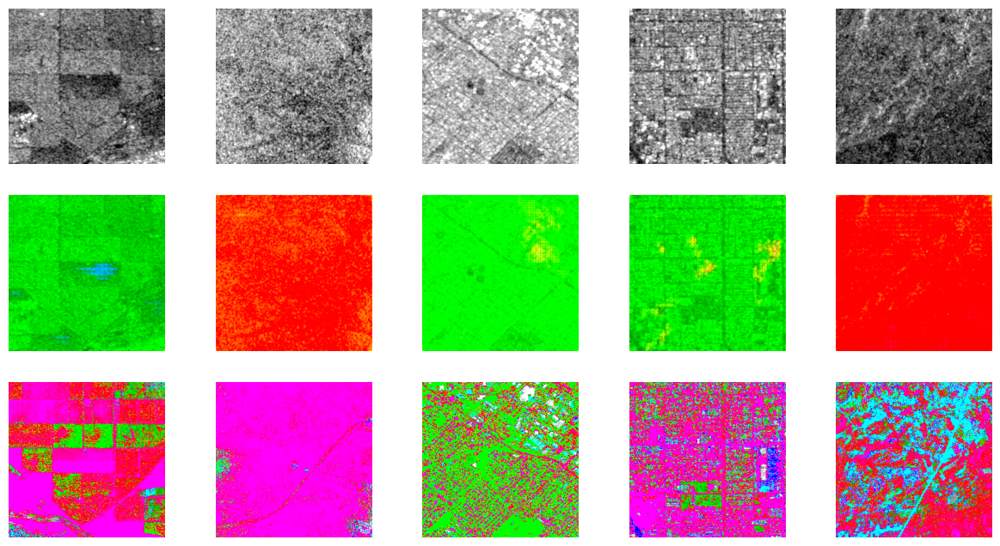

100%|█████████▉| 799/800 [07:46<00:00,  1.72it/s]


Epoch 2/20
Iteration 800/800
loss_D_fake: 0.00033
loss_D_real: 0.00024
loss_D: 0.00029
loss_G_GAN: 8.27051
loss_G_L1: 857.44158
loss_G: 865.71209


<ipython-input-24-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 47468 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-24-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 55284 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-24-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 41117 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-24-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 31400 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-24-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 62657 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-24-a66e46705176

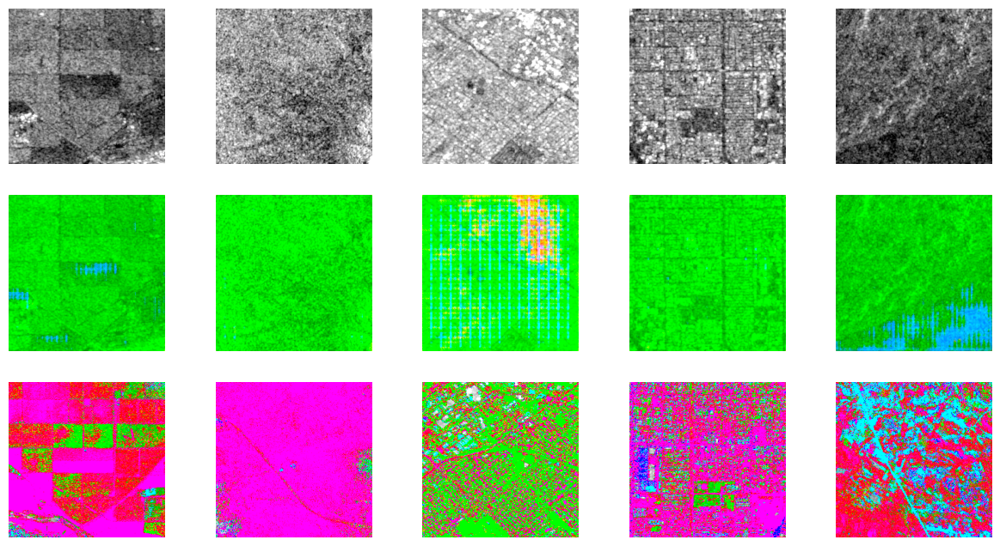

100%|█████████▉| 799/800 [07:47<00:00,  1.73it/s]


Epoch 3/20
Iteration 800/800
loss_D_fake: 0.00012
loss_D_real: 0.00009
loss_D: 0.00010
loss_G_GAN: 9.30349
loss_G_L1: 856.69202
loss_G: 865.99550


<ipython-input-24-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 38466 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-24-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 47481 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-24-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 58931 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-24-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 61462 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


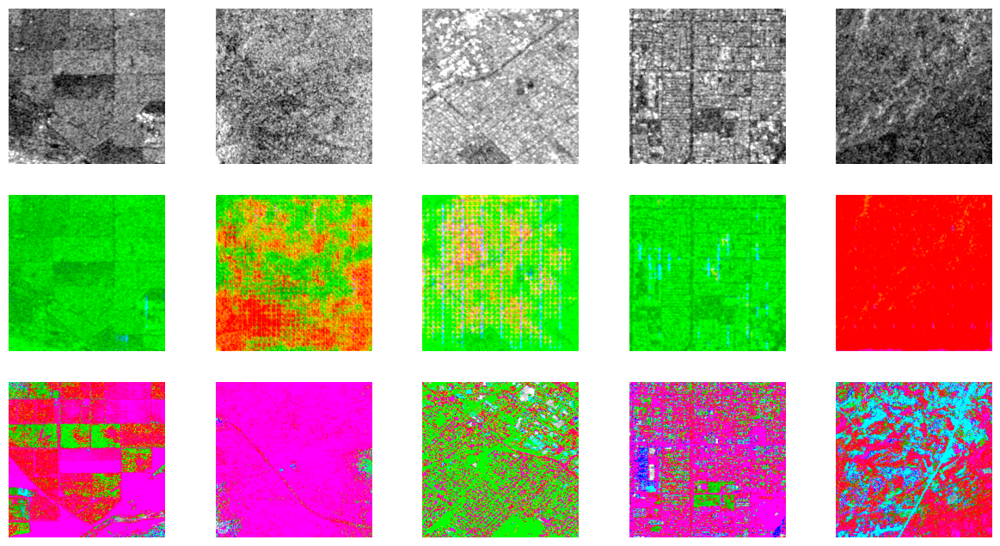

100%|█████████▉| 799/800 [07:46<00:00,  1.73it/s]


Epoch 4/20
Iteration 800/800
loss_D_fake: 0.00005
loss_D_real: 0.00004
loss_D: 0.00004
loss_G_GAN: 10.08091
loss_G_L1: 856.13206
loss_G: 866.21297


<ipython-input-24-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 59873 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-24-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 53591 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-24-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 53560 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-24-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 2851 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


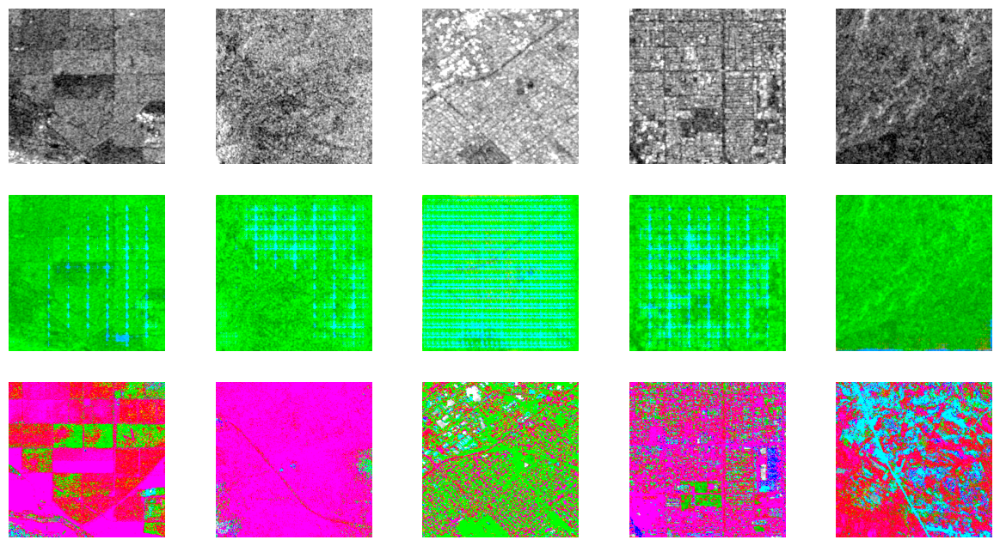

100%|█████████▉| 799/800 [07:47<00:00,  1.73it/s]


Epoch 5/20
Iteration 800/800
loss_D_fake: 0.00003
loss_D_real: 0.00002
loss_D: 0.00002
loss_G_GAN: 10.71754
loss_G_L1: 855.19812
loss_G: 865.91566


<ipython-input-24-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 31318 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


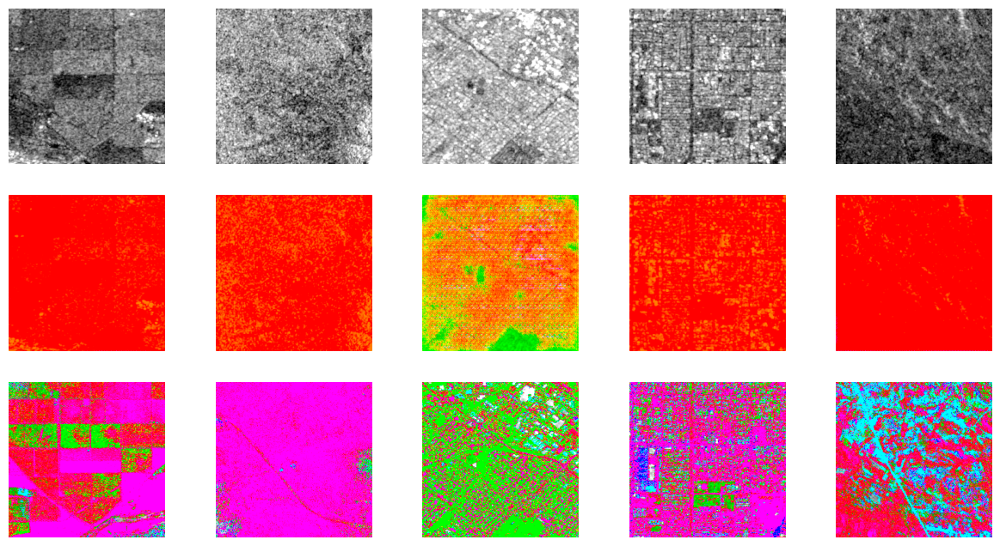

100%|█████████▉| 799/800 [07:47<00:00,  1.73it/s]


Epoch 6/20
Iteration 800/800
loss_D_fake: 0.00002
loss_D_real: 0.00001
loss_D: 0.00001
loss_G_GAN: 11.21212
loss_G_L1: 854.93962
loss_G: 866.15174


<ipython-input-24-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 51003 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


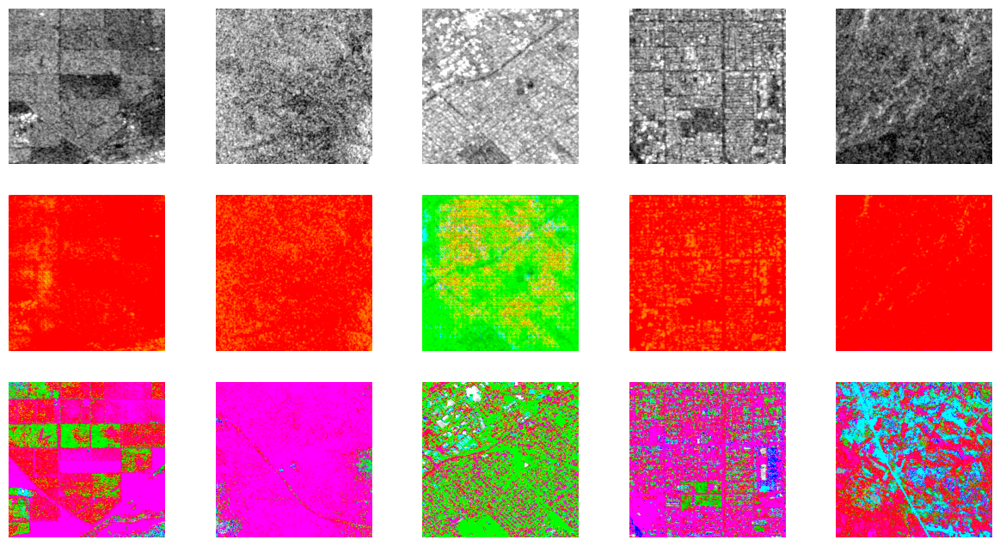

100%|█████████▉| 799/800 [07:47<00:00,  1.73it/s]


Epoch 7/20
Iteration 800/800
loss_D_fake: 0.00001
loss_D_real: 0.00001
loss_D: 0.00001
loss_G_GAN: 11.66022
loss_G_L1: 854.35472
loss_G: 866.01494


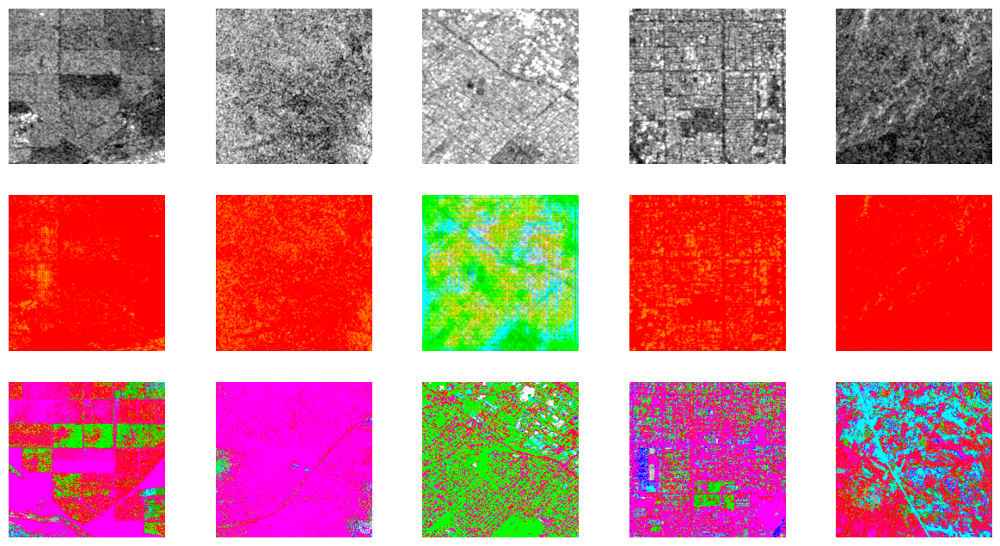

100%|█████████▉| 799/800 [07:47<00:00,  1.72it/s]


Epoch 8/20
Iteration 800/800
loss_D_fake: 0.00001
loss_D_real: 0.00000
loss_D: 0.00001
loss_G_GAN: 12.12281
loss_G_L1: 853.93666
loss_G: 866.05947


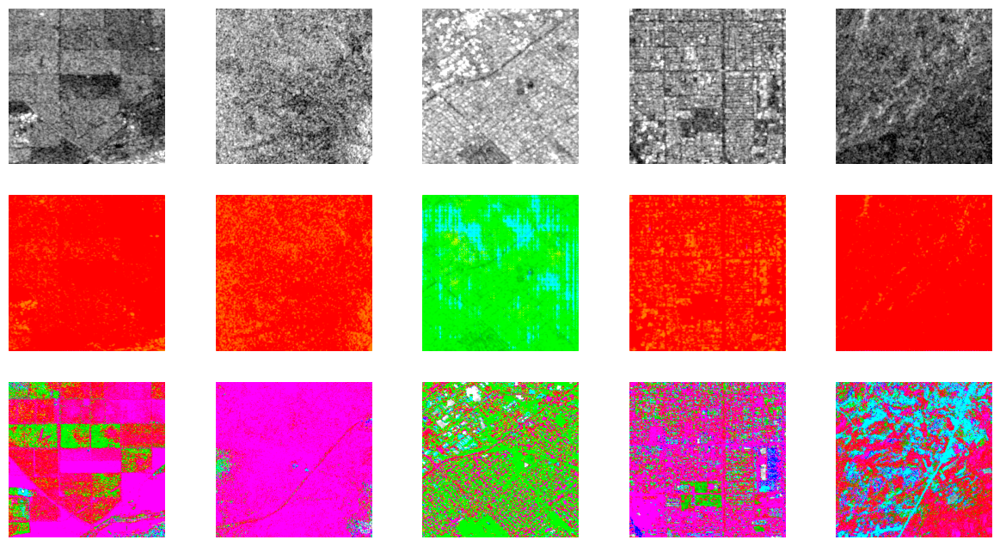

100%|█████████▉| 799/800 [07:47<00:00,  1.72it/s]


Epoch 9/20
Iteration 800/800
loss_D_fake: 0.00000
loss_D_real: 0.00000
loss_D: 0.00000
loss_G_GAN: 12.55926
loss_G_L1: 853.56566
loss_G: 866.12492


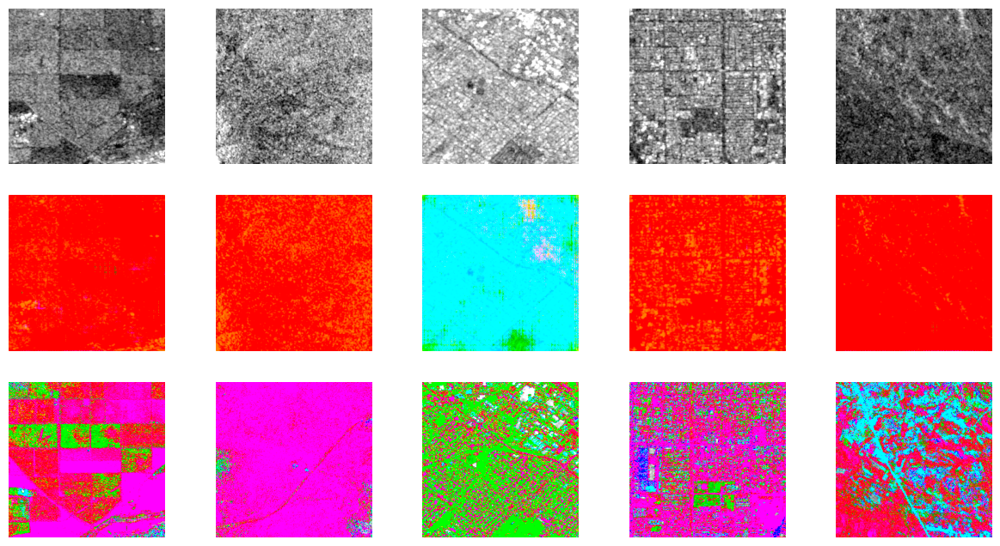

100%|█████████▉| 799/800 [07:47<00:00,  1.73it/s]


Epoch 10/20
Iteration 800/800
loss_D_fake: 0.00000
loss_D_real: 0.00000
loss_D: 0.00000
loss_G_GAN: 13.01141
loss_G_L1: 853.16443
loss_G: 866.17583


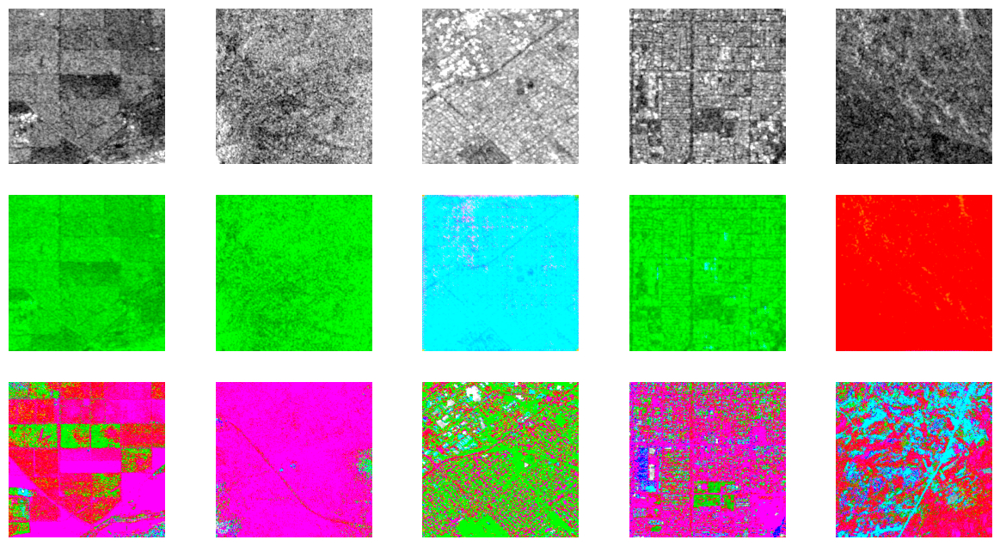

100%|█████████▉| 799/800 [07:47<00:00,  1.72it/s]


Epoch 11/20
Iteration 800/800
loss_D_fake: 0.00000
loss_D_real: 0.00000
loss_D: 0.00000
loss_G_GAN: 13.44390
loss_G_L1: 852.72523
loss_G: 866.16913


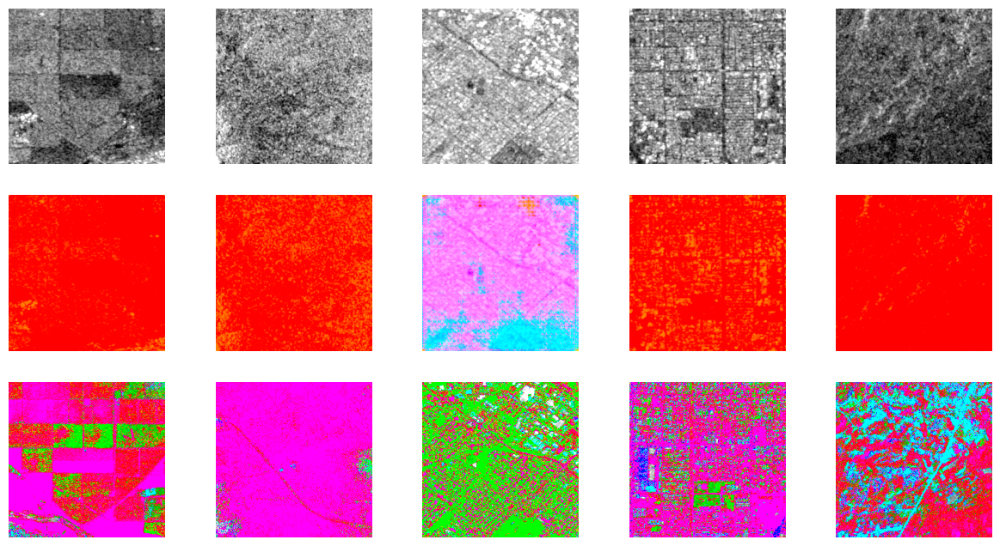

100%|█████████▉| 799/800 [07:46<00:00,  1.72it/s]


Epoch 12/20
Iteration 800/800
loss_D_fake: 0.00000
loss_D_real: 0.00000
loss_D: 0.00000
loss_G_GAN: 13.89300
loss_G_L1: 852.32670
loss_G: 866.21970


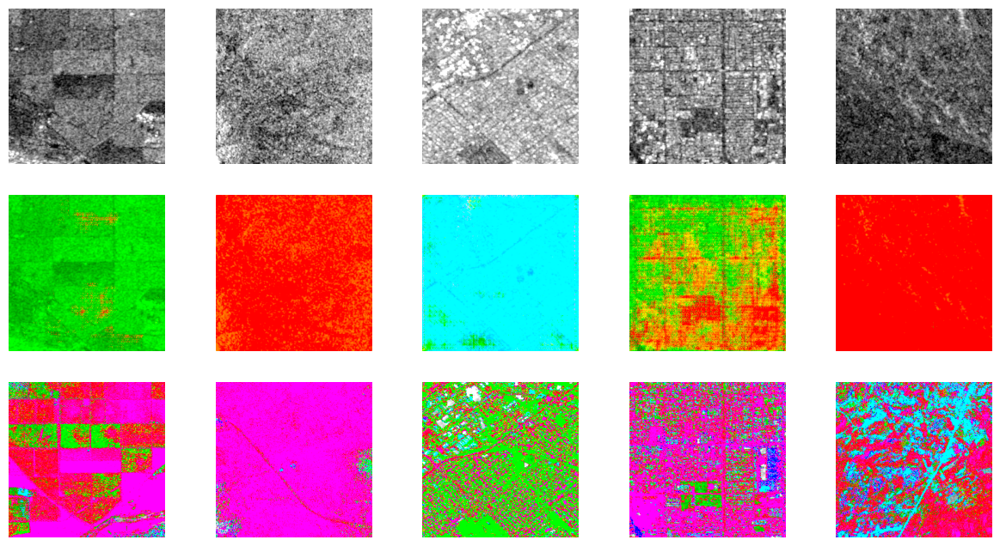

100%|█████████▉| 799/800 [07:47<00:00,  1.72it/s]


Epoch 13/20
Iteration 800/800
loss_D_fake: 0.08359
loss_D_real: 0.07677
loss_D: 0.08018
loss_G_GAN: 10.19523
loss_G_L1: 852.35626
loss_G: 862.55149


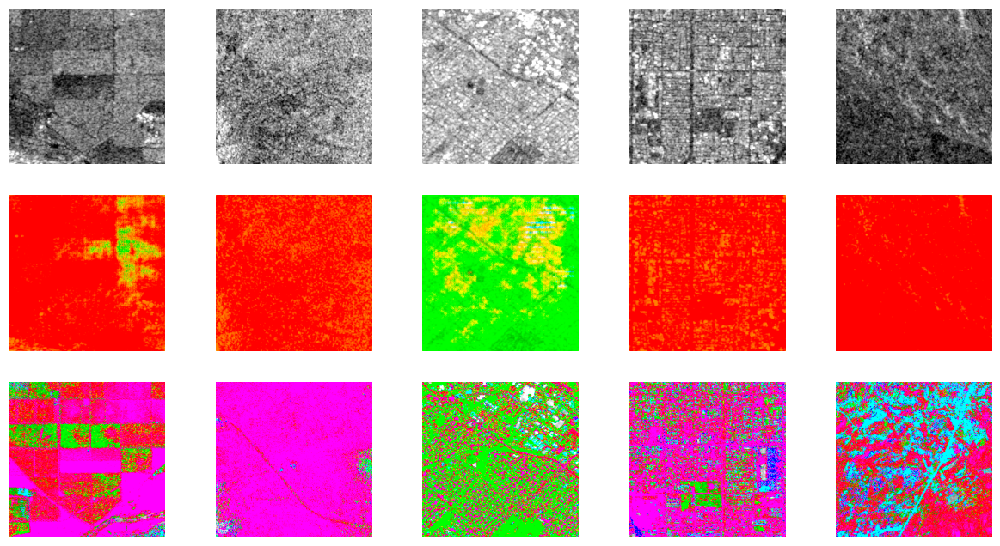

100%|█████████▉| 799/800 [07:47<00:00,  1.73it/s]


Epoch 14/20
Iteration 800/800
loss_D_fake: 0.00171
loss_D_real: 0.00199
loss_D: 0.00185
loss_G_GAN: 7.28467
loss_G_L1: 852.31756
loss_G: 859.60222


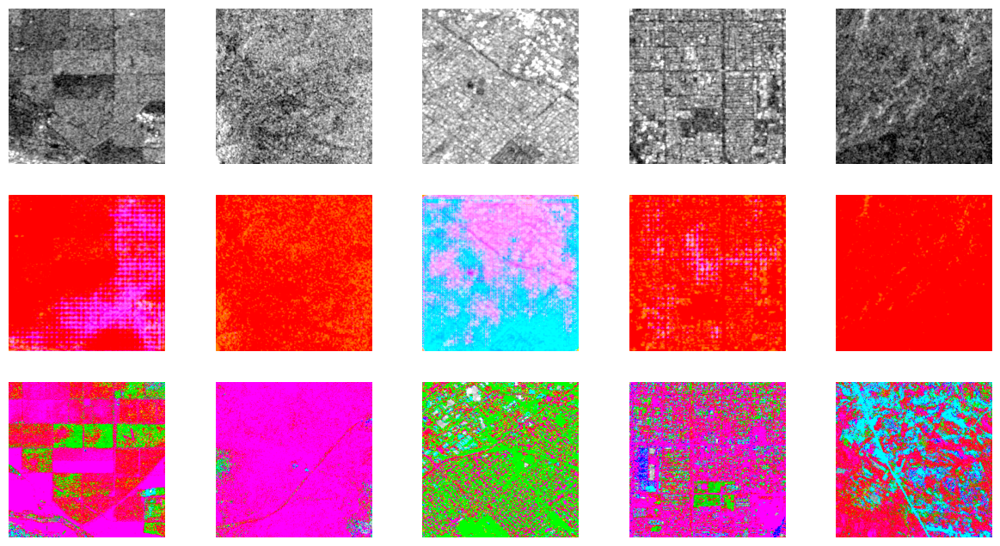

100%|█████████▉| 799/800 [07:46<00:00,  1.73it/s]


Epoch 15/20
Iteration 800/800
loss_D_fake: 0.00046
loss_D_real: 0.00051
loss_D: 0.00049
loss_G_GAN: 8.35431
loss_G_L1: 851.93773
loss_G: 860.29204


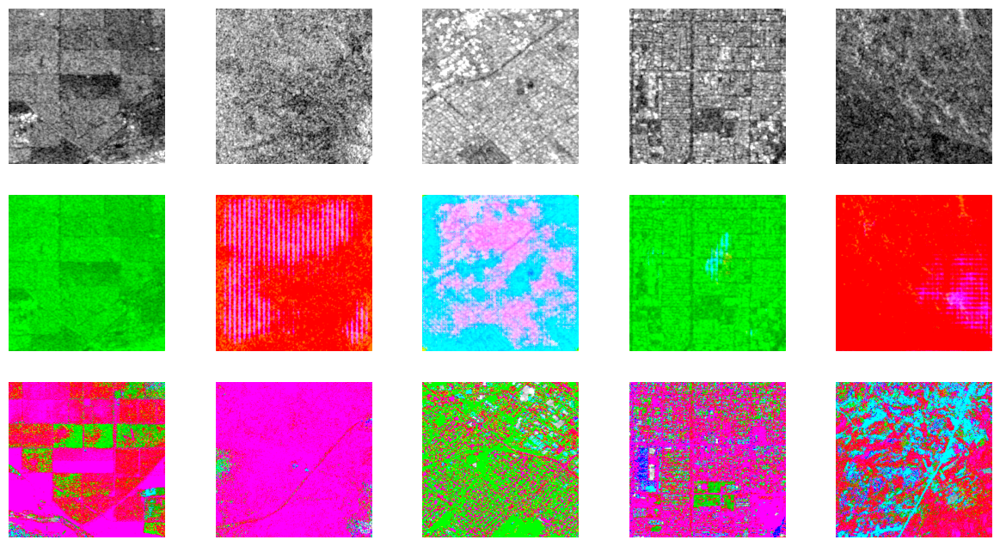

100%|█████████▉| 799/800 [07:47<00:00,  1.73it/s]


Epoch 16/20
Iteration 800/800
loss_D_fake: 0.00023
loss_D_real: 0.00024
loss_D: 0.00024
loss_G_GAN: 9.02348
loss_G_L1: 851.80975
loss_G: 860.83323


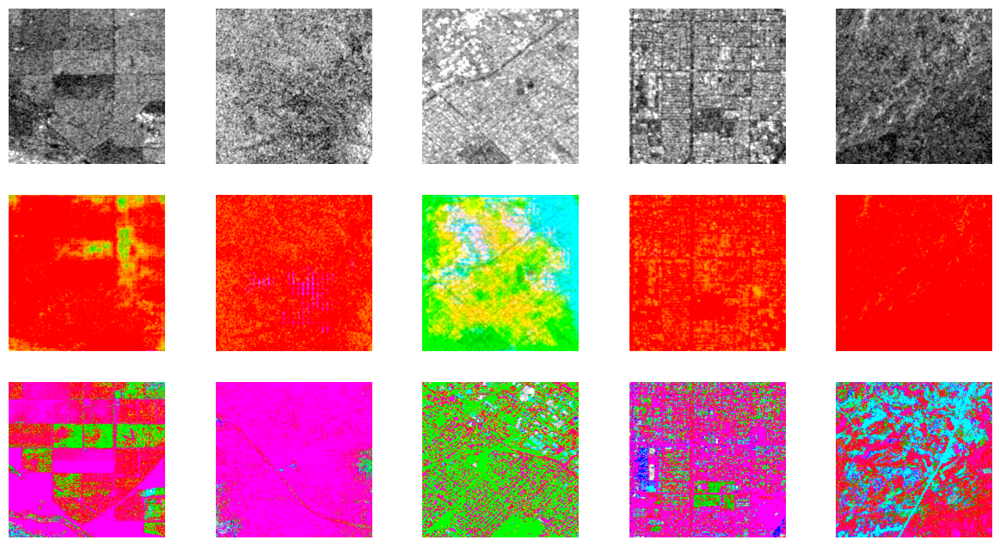

100%|█████████▉| 799/800 [07:46<00:00,  1.72it/s]


Epoch 17/20
Iteration 800/800
loss_D_fake: 0.00012
loss_D_real: 0.00012
loss_D: 0.00012
loss_G_GAN: 9.60624
loss_G_L1: 851.55414
loss_G: 861.16037


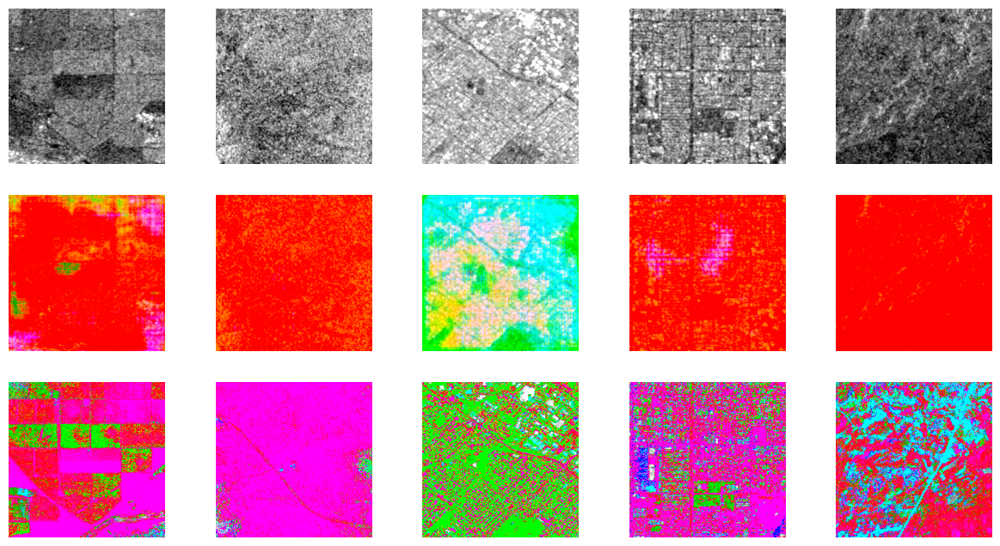

100%|█████████▉| 799/800 [07:46<00:00,  1.72it/s]


Epoch 18/20
Iteration 800/800
loss_D_fake: 0.00007
loss_D_real: 0.00007
loss_D: 0.00007
loss_G_GAN: 10.11037
loss_G_L1: 850.94013
loss_G: 861.05050


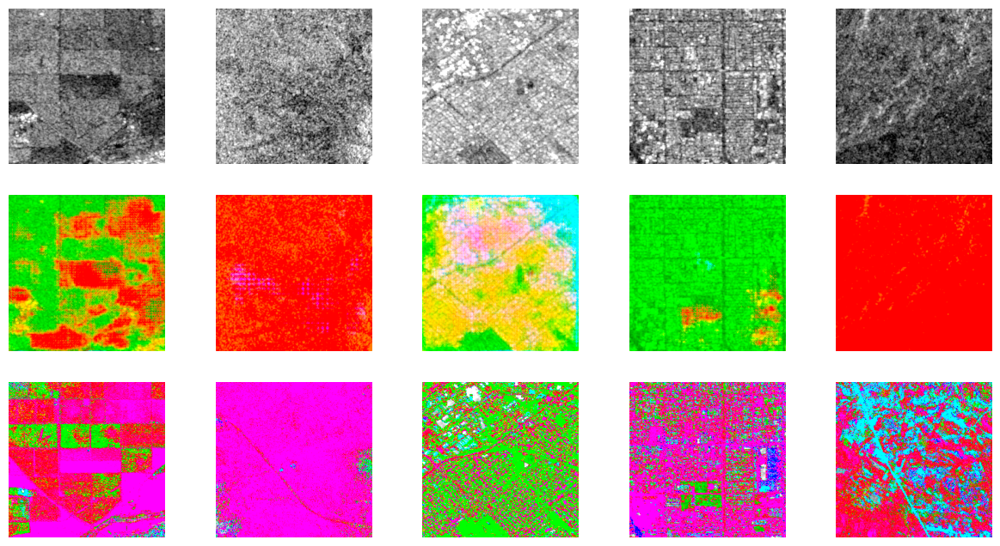

100%|█████████▉| 799/800 [07:47<00:00,  1.72it/s]


Epoch 19/20
Iteration 800/800
loss_D_fake: 0.00004
loss_D_real: 0.00004
loss_D: 0.00004
loss_G_GAN: 10.62840
loss_G_L1: 850.46138
loss_G: 861.08977


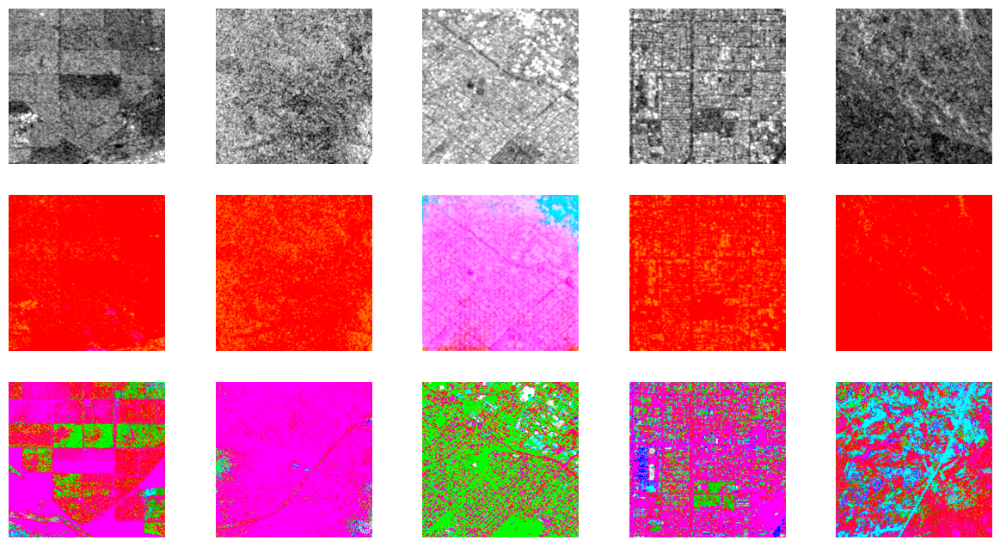

100%|█████████▉| 799/800 [07:47<00:00,  1.72it/s]


Epoch 20/20
Iteration 800/800
loss_D_fake: 0.00003
loss_D_real: 0.00003
loss_D: 0.00003
loss_G_GAN: 11.06387
loss_G_L1: 850.25150
loss_G: 861.31537


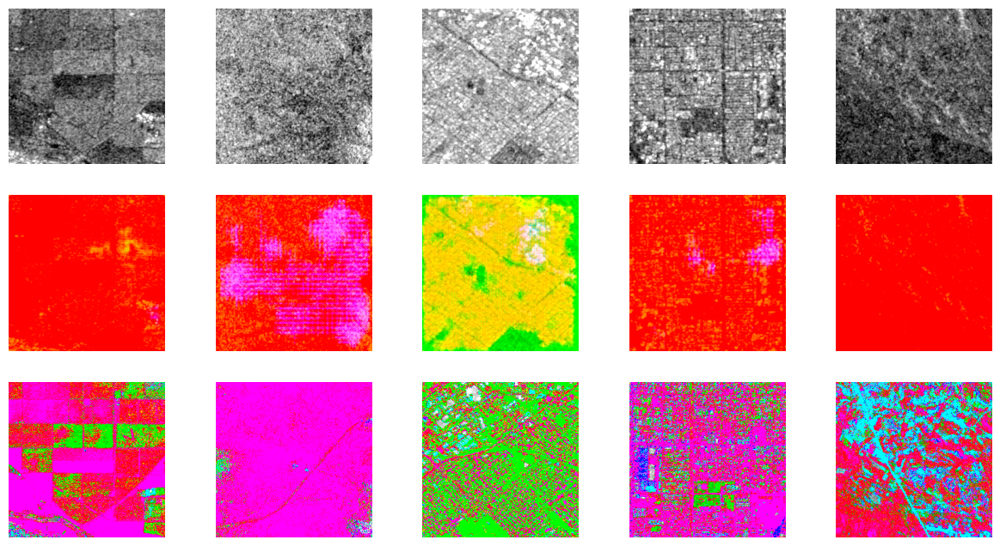

100%|██████████| 800/800 [07:49<00:00,  1.70it/s]


In [28]:
def train_model(model, train_dl, epochs, display_every=800):
    data = next(iter(val_dl)) # getting a batch for visualizing the model output after fixed intrvals
    for e in range(epochs):
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to
        i = 0                                  # log the losses of the complete network
        for data in tqdm(train_dl):
            model.setup_input(data)
            model.optimize()
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            i += 1
            if i % display_every == 0:
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                log_results(loss_meter_dict) # function to print out the losses
                visualize(model, data, save=False) # function displaying the model's outputs

model = MainModel()
model.to(device)

train_model(model, train_dl, 20)

In [29]:
torch.save(model.state_dict(), 'model_weights.pth')

In [30]:
from google.colab import files
files.download('model_weights.pth')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>